# Libraries import & setup

In [ ]:
!pip install diffusers accelerate transformers safetensors --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 85.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 79.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 38.2 MB/s eta 0:00:00


In [ ]:
!pip install -U peft --quiet

In [ ]:
from diffusers import StableDiffusionPipeline, DPMSolverMultistepScheduler, StableDiffusionImg2ImgPipeline
from huggingface_hub import InferenceClient, hf_hub_download, login
from IPython.display import Image as IPyImage, display
from PIL import Image
import torch
import ast
import re
import os
import cv2
import numpy as np
from openai import OpenAI
import openai

In [ ]:
login(token="")

# Step 1: Producing consistent frames via GPT-4o

In [ ]:
client = InferenceClient(
    provider="hf-inference",
    api_key="",
)

def generate_animation_frames(prompt, steps):
    system_message = (
        f"You are an animation assistant to help create ghibli-themed animation frames. "
        f"**Each frame must include the word 'ghibli' or describe the frame as 'ghibli-style'.** "
        f"Break the given ghibli-themed idea into a smooth {steps}-step animation, keeping each frame very simple. "
        f"Do not stray from the given ghibli idea, simple break it into frames that I can use to create a smooth and consistent ghibli animation. "
        f"Each frame must describe only the current ghibli scene, and it must be a simple description. "
        f"Return the result as a **Python list of {steps} strings**, where each string describes a single still frame. "
        f"Do NOT include any titles, explanations, code, formatting, or object coordinates — only a plain list of strings."
        f"Here is an example:\n['A ghibli-themed boy opens a door.', 'He steps into a ghibli glowing forest.', ...]"
    )

    completion = client.chat.completions.create(
        model="mistralai/Mistral-7B-Instruct-v0.3",
        messages=[
            {"role": "system", "content": system_message},
            {"role": "user", "content": prompt}
        ]
    )

    return completion.choices[0].message.content

In [ ]:
def generate_animation_frames_openai(prompt, steps):
    system_message = (
        f"You are an animation assistant to help create ghibli-themed animation frames. "
        f"Each frame must include the word 'ghibli' or describe the frame as 'ghibli-style'. "
        f"Break the given ghibli-themed idea into a smooth {steps}-step animation, keeping each frame very simple. "
        f"Do not stray from the given ghibli idea — simply break it into frames that I can use to create a smooth and consistent ghibli animation. "
        f"Each frame must describe only the current ghibli scene, and must be a simple sentence. "
        f"Return the result as a **Python list of {steps} strings**, with no extra formatting, no titles, and no explanation. "
        f"Example:\n['A ghibli-themed boy opens a door.', 'He steps into a ghibli glowing forest.', ...]"
    )

    response = openai.chat.completions.create(
        model="gpt-4o-mini",
        messages=[
            {"role": "system", "content": system_message},
            {"role": "user", "content": prompt}
        ],
        temperature=0.7
    )

    return response.choices[0].message.content

In [ ]:
def normalize_llm_frame_output(raw_output, steps):
    # Try parsing as a Python list (only if it starts and ends with brackets)
    if raw_output.strip().startswith("[") and raw_output.strip().endswith("]"):
        try:
            parsed = ast.literal_eval(raw_output)
            if isinstance(parsed, list) and all(isinstance(item, str) for item in parsed):
                return parsed[:steps]
        except Exception:
            pass

    # Fallback 1: Numbered lines like 1. "..."
    pattern = re.compile(r'\d+\s*[\.\)]\s*["“]?(.*?)["”]?(?=\n\d+|\Z)', re.DOTALL)
    matches = pattern.findall(raw_output)

    # Fallback 2: Bullet points or stray quoted lines
    if not matches:
        matches = re.findall(r'["“”\']([^"\n]+)["“”\']', raw_output)

    # Fallback 3: Rough line-by-line fallback if nothing matches
    if not matches:
        matches = [line.strip("-• \n") for line in raw_output.splitlines() if len(line.strip()) > 3]

    # Clean up stray characters
    cleaned = []
    for m in matches[:steps]:
        m = m.replace("‘", "").replace("’", "'").replace("“", "").replace("”", "").strip()
        cleaned.append(m)

    return cleaned

---
# Step 2: text-to-image for first frame

In [ ]:
base_model = "runwayml/stable-diffusion-v1-5"
pipe = StableDiffusionPipeline.from_pretrained(base_model, safety_checker=None, torch_dtype=torch.float16)
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)
pipe.to("cuda")

In [ ]:
lora_repo = "ibrahim7004/ghibli-stableDiff-finetuned"
lora_filename = "v2_pytorch_lora_weights.safetensors"

lora_path = hf_hub_download(repo_id=lora_repo, filename=lora_filename)
pipe.unet.load_attn_procs(lora_path)

In [ ]:
def save_img(image, idx, output_dir="/content/frames"):
    os.makedirs(output_dir, exist_ok=True)
    image_path = os.path.join(output_dir, f"frame_{idx}.png")
    image.save(image_path)

    init_image = Image.open(image_path).convert("RGB")
    init_image = init_image.resize((512, 512))
    return init_image

----
# Step 3: img2img for remaining frames

In [ ]:
img2img_pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    safety_checker=None,
    torch_dtype=torch.float16
).to("cuda")

img2img_pipe.unet.load_attn_procs(lora_path)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_img2img.StableDiffusionImg2ImgPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


---

In [ ]:
import os
from PIL import Image
import numpy as np
import cv2
from skimage.metrics import structural_similarity as ssim
from IPython.display import display

def calculate_ssim(image1, image2):
    """Convert to grayscale and calculate SSIM."""
    img1 = np.array(image1.convert("L"))
    img2 = np.array(image2.convert("L"))

    if img1.shape != img2.shape:
        img2 = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

    score, _ = ssim(img1, img2, full=True)
    return score

def generate_frames(frames, ssim_threshold=0.8):
    initial_image = None
    base_image = None

    for idx, frame in enumerate(frames):
        if idx == 0:
            image = pipe(
                prompt=frame,
                num_inference_steps=50,
                guidance_scale=8.5
            ).images[0]
            initial_image = save_img(image, idx)
            base_image = initial_image
            display(image)
        else:
            refined = img2img_pipe(
                prompt=frame,
                image=base_image,
                strength=0.25,
                guidance_scale=5.5,
                num_inference_steps=50
            ).images[0]
            display(refined)
            saved = save_img(refined, idx)

            # Check for drift
            similarity = calculate_ssim(saved, initial_image)
            print(f"Frame {idx}: SSIM with frame 0 = {similarity:.3f}")

            if similarity < ssim_threshold:
                print(f"⚠️  Style drift detected at frame {idx}. Resetting base image to frame 0.")
                base_image = initial_image
            else:
                base_image = saved

In [ ]:
def create_gif_from_frames(folder_path="/content/frames", output_path="/content/animation.gif", duration=300):

    frames = sorted(
        [Image.open(os.path.join(folder_path, f)) for f in os.listdir(folder_path) if f.endswith(".png")],
        key=lambda x: int(os.path.splitext(os.path.basename(x.filename))[0].split('_')[-1])
    )

    frames[0].save(output_path, format="GIF", save_all=True, append_images=frames[1:], duration=duration, loop=0)
    print(f"GIF saved to {output_path}")

    display(IPyImage(filename=output_path))

In [ ]:
def blend_frames(img1, img2, alpha):
    return Image.blend(img1, img2, alpha)

def create_smooth_gif(folder_path="/content/frames", output_path="/content/animation.gif", duration=250):
    # Load and sort frames
    frame_files = sorted(
        [f for f in os.listdir(folder_path) if f.endswith(".png")],
        key=lambda x: int(x.split('_')[-1].split('.')[0])
    )
    frames = [Image.open(os.path.join(folder_path, f)).convert("RGB") for f in frame_files]

    # Add blended frames between originals
    smooth_frames = []
    for i in range(len(frames) - 1):
        smooth_frames.append(frames[i])
        # Add intermediate frame(s) between i and i+1
        blend = blend_frames(frames[i], frames[i+1], alpha=0.5)
        smooth_frames.append(blend)
    smooth_frames.append(frames[-1])  # Last frame

    # Save as GIF
    smooth_frames[0].save(
        output_path,
        format="GIF",
        save_all=True,
        append_images=smooth_frames[1:],
        duration=duration,
        loop=0
    )
    print(f"Smooth GIF saved to {output_path}")
    display(IPyImage(filename=output_path))

# Main

a serene forest with glowing sunlight passing through lush trees, the trees sway as wind passes and the light flickers as the camera pans through the leaves of the trees. Make the frames about this prompt only and dont add anything extra

Enter an animation sequence: a serene forest with glowing sunlight passing through lush trees, the trees sway as wind passes and the light flickers as the camera pans through the leaves of the trees. Make the frames about this prompt only and dont add anything extra
["A tranquil ghibli forest appears.",
"Golden sunlight filters through the lush ghibli forest.",
"The ghibli trees sway gently in the wind.",
"The sunlight flickers among the ghibli trees.",
"The camera slowly pans through the ghibli forest.",
"A glowing stream meanders between the ghibli trees.",
"The forest floor is bedecked with green moss and fallen leaves.",
"Butterflies flit about in the dappled sunlight of the ghibli forest.",
"A ghibli-style creature shyly peeks from behind a tree.",
"A rustic wooden bridge arches over the glowing stream.",
"A hummingbird flits across the camera's path in the ghibli forest.",
"A ghibli-style house emerges amidst the forest",
"The sun begins to set through the ghibli forest's canopy"

  0%|          | 0/50 [00:00<?, ?it/s]

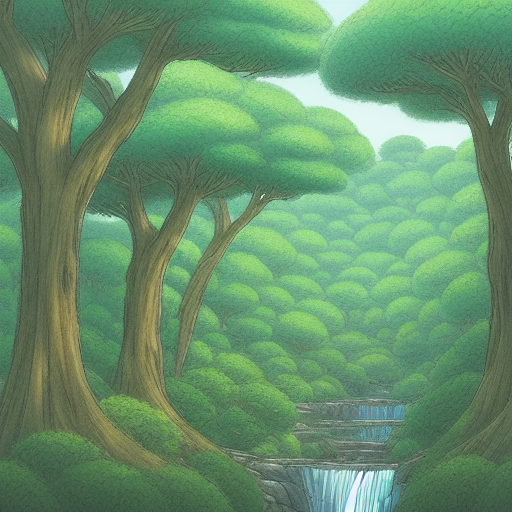

  0%|          | 0/12 [00:00<?, ?it/s]

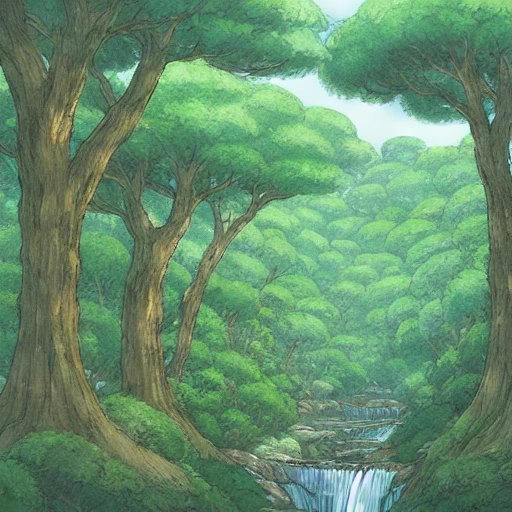

Frame 1: SSIM with frame 0 = 0.437
⚠️  Style drift detected at frame 1. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

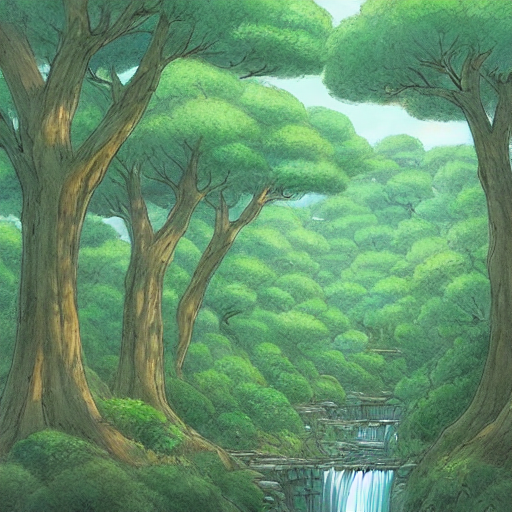

Frame 2: SSIM with frame 0 = 0.440
⚠️  Style drift detected at frame 2. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

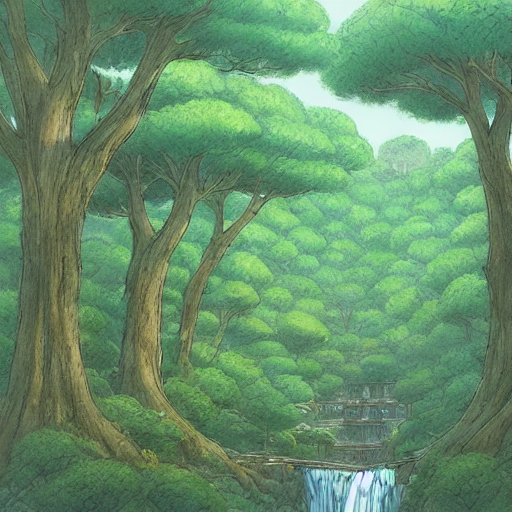

Frame 3: SSIM with frame 0 = 0.440
⚠️  Style drift detected at frame 3. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

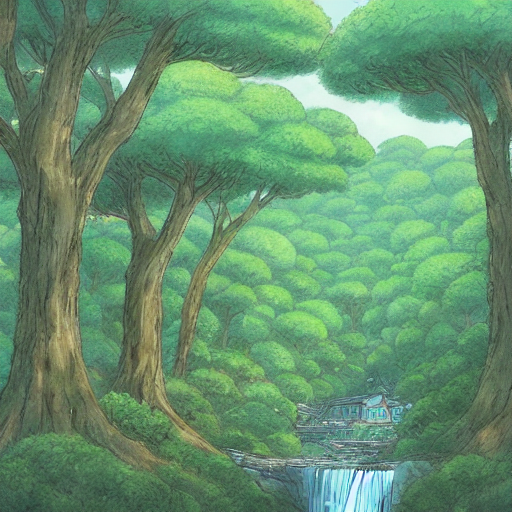

Frame 4: SSIM with frame 0 = 0.444
⚠️  Style drift detected at frame 4. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

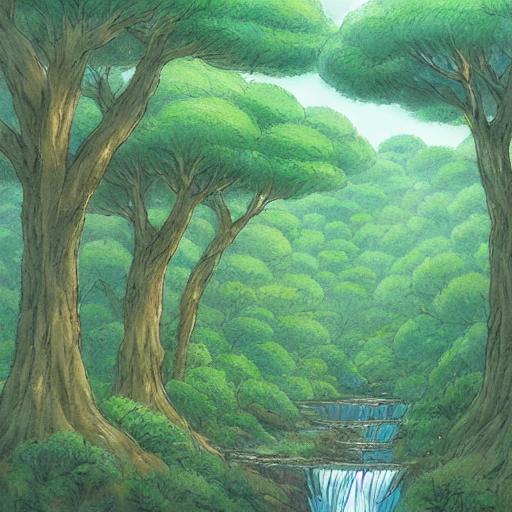

Frame 5: SSIM with frame 0 = 0.432
⚠️  Style drift detected at frame 5. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

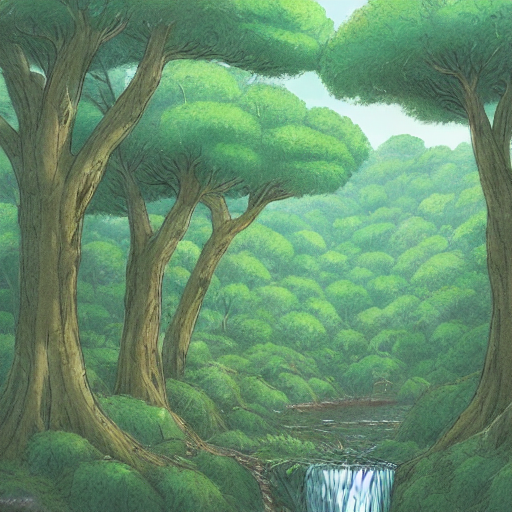

Frame 6: SSIM with frame 0 = 0.460
⚠️  Style drift detected at frame 6. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

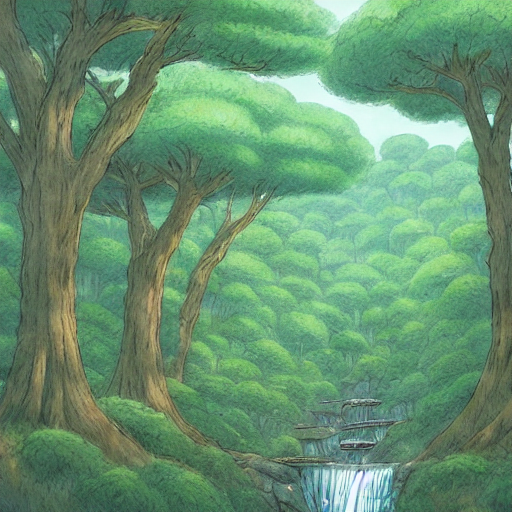

Frame 7: SSIM with frame 0 = 0.449
⚠️  Style drift detected at frame 7. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

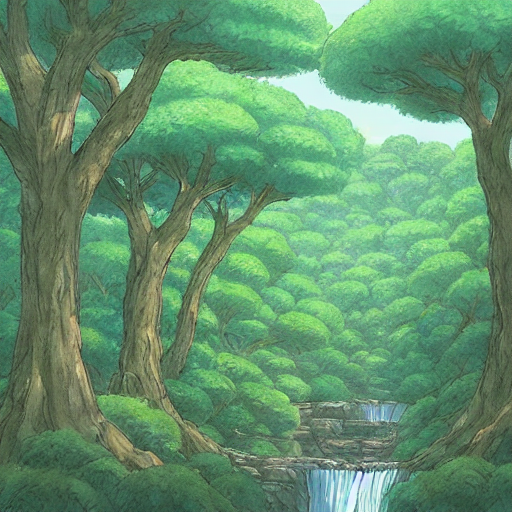

Frame 8: SSIM with frame 0 = 0.423
⚠️  Style drift detected at frame 8. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

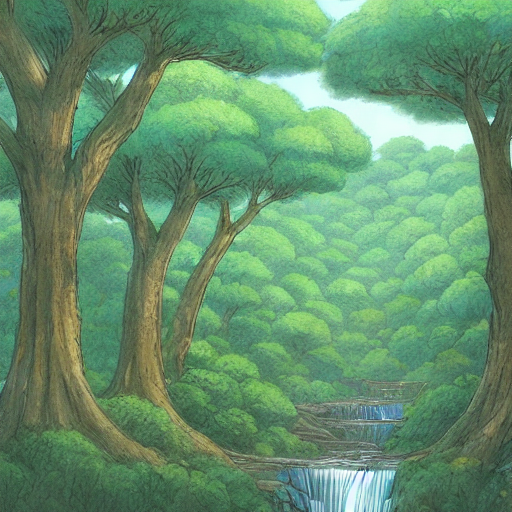

Frame 9: SSIM with frame 0 = 0.456
⚠️  Style drift detected at frame 9. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

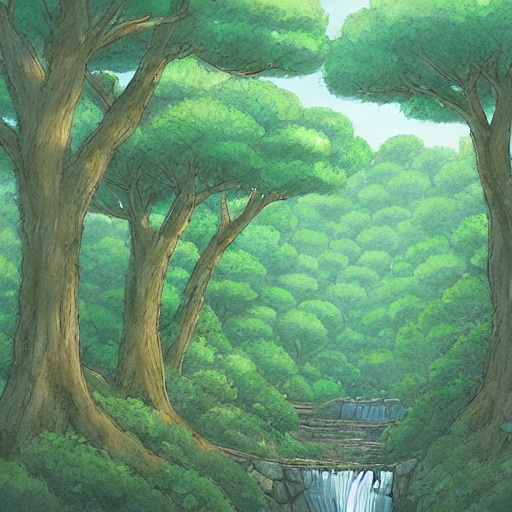

Frame 10: SSIM with frame 0 = 0.449
⚠️  Style drift detected at frame 10. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

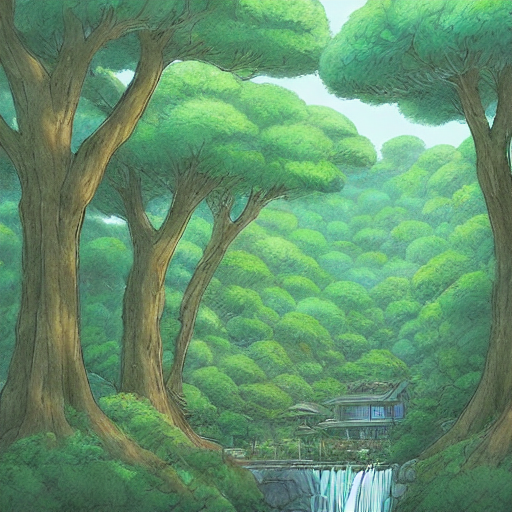

Frame 11: SSIM with frame 0 = 0.447
⚠️  Style drift detected at frame 11. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

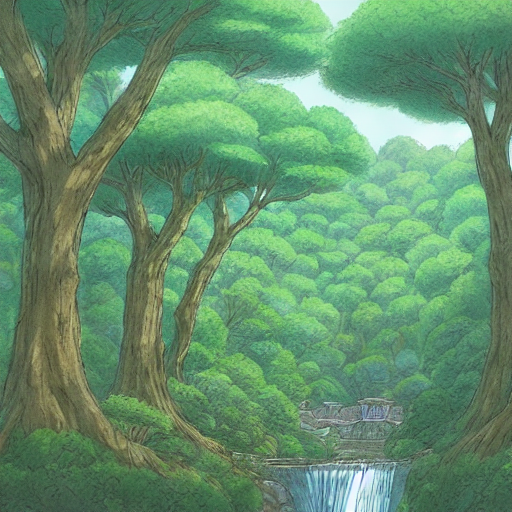

Frame 12: SSIM with frame 0 = 0.439
⚠️  Style drift detected at frame 12. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

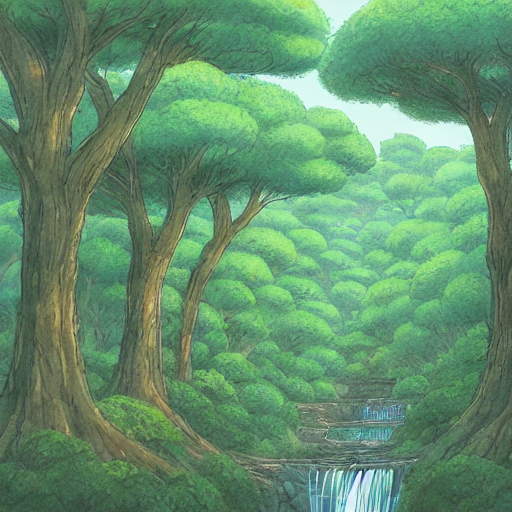

Frame 13: SSIM with frame 0 = 0.441
⚠️  Style drift detected at frame 13. Resetting base image to frame 0.


  0%|          | 0/12 [00:00<?, ?it/s]

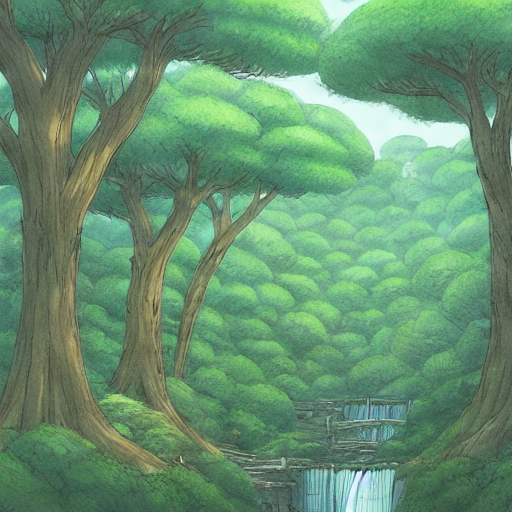

Frame 14: SSIM with frame 0 = 0.471
⚠️  Style drift detected at frame 14. Resetting base image to frame 0.


In [ ]:
result = generate_animation_frames(input("Enter an animation sequence: "), 15)
print(result)
frames = normalize_llm_frame_output(result, 15)
print(frames)
generate_frames(frames)

GIF saved to /content/animation.gif


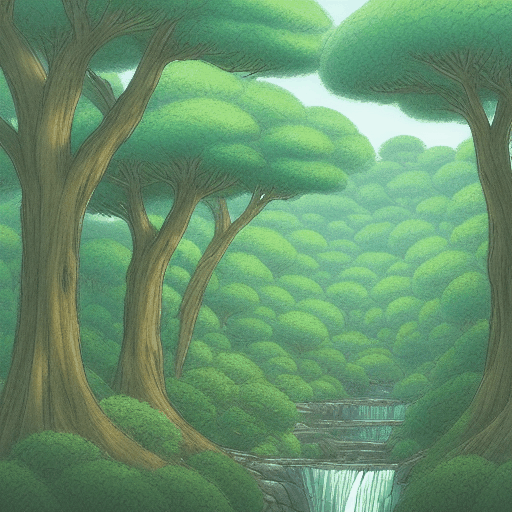

In [ ]:
create_gif_from_frames()

Smooth GIF saved to /content/animation.gif


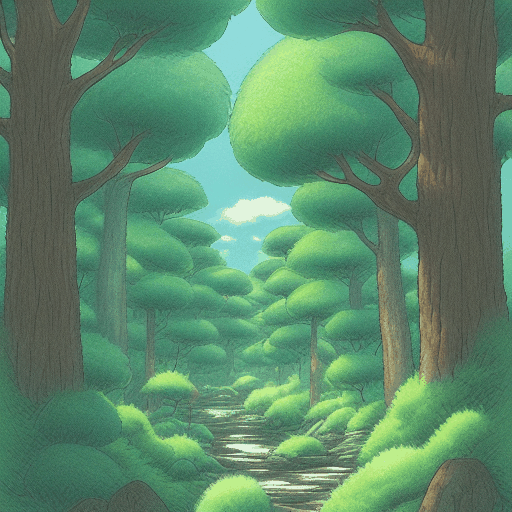

In [ ]:
create_smooth_gif()